In [1]:
import pandas as pd
import numpy as np
import scipy as sc
import matplotlib.pyplot as plt
import holopy as hp

def loadFestoLog(FFESTO):
    opt = {
        "delimiter" : ";",
        "names" : ["DATE", "X", "Y", "Z"]
    }
    festoLog = pd.read_csv(FFESTO, **opt)
    festoLog.DATE = pd.to_datetime(festoLog.DATE,  unit="ms")

    festoLog.X = festoLog.X/1000
    festoLog.Y = festoLog.Y/1000
    festoLog.Z = festoLog.Z/1000
    
    DATE = festoLog
    return DATE

def loadPlutoLog(FPLUTO):
    opt = {
        "delimiter" : " ",
        "names" : ["DATE", "FREQUENCY_TX", "FREQUENCY_RX", "MOD_I", "PHASE_I", "MOD_Q", "PHASE_Q", "MOD", "PHASE"],
        "dtype" : {'FREQUENCY_TX': float, 'FREQUENCY_RX': float, 'MOD_I': float, 
                   'PHASE_I': float, 'MOD_Q': float, 'PHASE_Q': float, 'MOD': float, 'PHASE': float},
        "parse_dates": ["DATE"],
        "date_parser": lambda x: pd.to_datetime(x, format="%Y/%m/%d-%H:%M:%S.%f"),
        "skipinitialspace": True,
        "skiprows": 1
    }

    plutoScan = pd.read_csv(FPLUTO, **opt)
    DATE = plutoScan
    return DATE

In [2]:

festo_file_path = '/home/lbisognin/Asmara/IN_SCAN/TraceData_0229_2_A.csv'
pluto_file_path = '/home/lbisognin/Asmara/IN_SCAN/plutoScan_0229_2_A.log'

# definisco costanti
NEIG = "none"
INTM = "natural"
TOFF = 0
P1 = loadFestoLog(festo_file_path)
co, ce = np.histogram(P1.Z, 1000)
cx = np.argmax(co)
H = ce[cx]*1000
P2 = loadPlutoLog(pluto_file_path)
P2.DATE = P2.DATE + pd.to_timedelta(TOFF * 1e-3, unit='s') #TOFF inutile dato che mantiene valore 0 per tutto il programma

/tmp/ipykernel_30920/3384195941.py:34: FutureWarning: The argument 'date_parser' is deprecated and will be removed in a future version. Please use 'date_format' instead, or read your data in as 'object' dtype and then call 'to_datetime'.
  plutoScan = pd.read_csv(FPLUTO, **opt)


In [3]:

#verifico saturazione segnali
if any((abs(P2.MOD_I * np.sin(P2.PHASE_I)) >= 2**11-1) | (abs(P2.MOD_I * np.cos(P2.PHASE_I)) >= 2**11-1)): 
    print('WARNING: signal I is saturated.')
if any((abs(P2.MOD_Q * np.sin(P2.PHASE_Q)) >= 2**11-1)| (abs(P2.MOD_Q * np.cos(P2.PHASE_Q)) >= 2**11-1)):
    print('WARNING: signal Q is saturated.')

In [4]:

#Index of PLUTO's data within FESTO's time window
P_ix = np.where((P2.DATE >= min(P1.DATE)) & (P2.DATE <= max(P1.DATE)))
P_F = P2.FREQUENCY_TX[P_ix[0]] #P_ix it's a list of arrays
P_F_UNIQUE = np.unique(P_F)
P_F_UNIQUE = np.sort(P_F_UNIQUE)

In [5]:
print(P2.DATE)
#P_DATE = np.empty(len(P_ix[0]), dtype="datetime64[ns]")
P_DATE = P2.DATE[P_ix[0]]

0      2024-02-29 10:39:12.030141
1      2024-02-29 10:39:12.055092
2      2024-02-29 10:39:12.072038
3      2024-02-29 10:39:12.115235
4      2024-02-29 10:39:12.133346
                  ...            
6457   2024-02-29 10:41:39.595645
6458   2024-02-29 10:41:39.624008
6459   2024-02-29 10:41:39.641210
6460   2024-02-29 10:41:39.658831
6461   2024-02-29 10:41:39.691420
Name: DATE, Length: 6462, dtype: datetime64[ns]


In [6]:
P_MOD = P2.MOD[P_ix[0]]
P_MOD

80      1961.0
81      1961.0
82      1961.0
83      1962.0
84      1962.0
         ...  
6296    1970.0
6297    1969.0
6298    1969.0
6299    1968.0
6300    1968.0
Name: MOD, Length: 6221, dtype: float64

In [7]:
P_PHASE = P2.PHASE[P_ix[0]]
P_PHASE

80      0.065
81      0.066
82      0.064
83      0.066
84      0.064
        ...  
6296    0.050
6297    0.051
6298    0.051
6299    0.053
6300    0.053
Name: PHASE, Length: 6221, dtype: float64

In [8]:
#festo data
F_X = P1.X
F_Y = P1.Y
F_DATE = P1.DATE

In [9]:
FFMOD = []
FFPHASE = []

In [10]:
P_X = []
P_Y = []
for n in range(0, len(P_F_UNIQUE)):
    P_X.append(np.interp(P_DATE, F_DATE,  F_X, left=np.nan, right=np.nan))
    P_Y.append(np.interp(P_DATE, F_DATE,  F_Y, left=np.nan, right=np.nan))

In [81]:
px = np.array(P_X[0])
py = np.array(P_Y[0])

In [12]:
import numpy as np
from scipy.interpolate import griddata

# Definizione della griglia regolare
xi = np.linspace(min(px), max(px), 6298)
yi = np.linspace(max(py), min(py), 6298)

# Interpolazione dei dati sparsi sulla griglia regolare
FFMOD = griddata((px, py), P_MOD.values, (xi[None, :], yi[:, None]), method = "linear")
FFPHASE = griddata((px, py), P_PHASE.values, (xi[None, :], yi[:, None]), method = "linear")

# zi conterrà i valori interpolati sulla griglia regolare


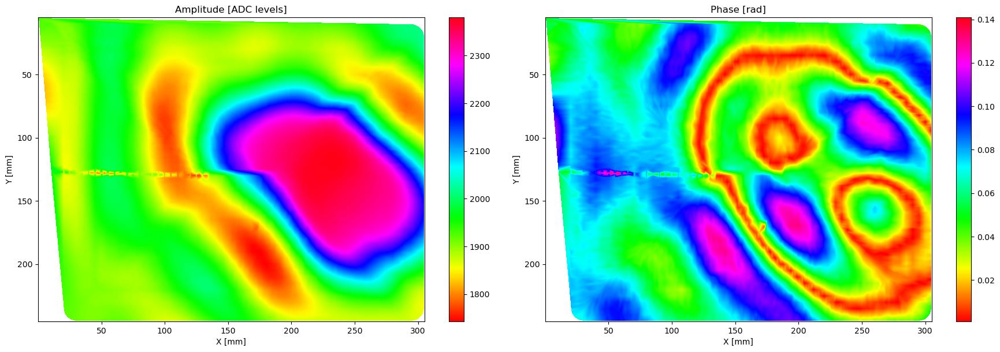

In [158]:
FFMOD[np.isnan(FFMOD)] = np.min(FFMOD)
FFPHASE[np.isnan(FFPHASE)] = np.min(FFPHASE)
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(18, 12))
im1 = ax1.imshow(FFMOD, extent=(min(px), max(px), max(py), min(py)), origin='lower', cmap='hsv')
ax1.set_title('Amplitude [ADC levels]')
ax1.set_xlabel('X [mm]')
ax1.set_ylabel('Y [mm]')
plt.colorbar(im1, ax=ax1, shrink=0.45)
im2 = ax2.imshow(FFPHASE, extent=(min(px), max(px), max(py), min(py)), origin='lower', cmap='hsv')
ax2.set_title('Phase [rad]')
ax2.set_xlabel('X [mm]')
ax2.set_ylabel('Y [mm]')
plt.colorbar(im2, ax=ax2, shrink=0.45)
plt.tight_layout()
#plt.savefig('/Users/breakfastea/Documents/Asmara/images/image.png', dpi=300)
#plt.show()

In [156]:
FFMOD[np.isnan(FFMOD)] = 0
FFPHASE[np.isnan(FFPHASE)] = 0
fourier_transform = FFMOD * np.exp(1j * FFPHASE)

In [157]:
fourier_transform = np.abs(fourier_transform)

In [152]:
def fill_zeros_discretized_enhanced(data):
    rows, cols = data.shape

    # Sostituisce gli zeri nelle prime colonne
    for i in range(rows):
        non_zero_indices = np.nonzero(data[i, :])[0]
        if non_zero_indices.size > 0:
            first_non_zero = data[i, non_zero_indices[0]]
            data[i, :non_zero_indices[0]] = first_non_zero

    # Sostituisce gli zeri nelle prime righe
    for j in range(cols):
        non_zero_indices = np.nonzero(data[:, j])[0]
        if non_zero_indices.size > 0:
            for zero_idx in np.where(data[:non_zero_indices[0], j] == 0)[0]:
                if zero_idx < (0.05 * rows):
                    data[zero_idx, j] = data[non_zero_indices[0], j]
    return data

In [139]:
def zero_normalization2(array):
    rows, columns = array.shape
    for i in range(rows):
        for j in range(columns):
            if array[i, j] == 0:
                for ii in range(rows):
                    if array[i,j] != 0:
                        break
                    if array[ii, j] != 0:
                        array[i, j] = array[ii, j]
                        print(f"{i}, {j}")
    return array

In [95]:
def zero_normalization(array):
    rows, columns = array.shape
    for i in range(0,rows):
        for j in range (0,columns):
            if array[i,j] == 0:
                for ii in range (0, rows):
                    if array[i,j] != 0:
                        break
                    for jj in range (0, columns):
                        if array[ii,jj] != 0:
                            array[i,j] = array[ii,jj]
                            break
    return array

In [160]:
fourier_transform = zero_normalization2(fourier_transform)

0, 1
0, 2
0, 3
0, 4
0, 5
0, 6
0, 7
0, 8
0, 9
0, 10
0, 11
0, 12
0, 13
0, 14
0, 15
0, 16
0, 17
0, 18
0, 19
0, 20
0, 21
0, 22
0, 23
0, 24
0, 25
0, 26
0, 27
0, 28
0, 29
0, 30
0, 31
0, 32
0, 33
0, 34
0, 35
0, 36
0, 37
0, 38
0, 39
0, 40
0, 41
0, 42
0, 43
0, 44
0, 45
0, 46
0, 47
0, 48
0, 49
0, 50
0, 51
0, 52
0, 53
0, 54
0, 55
0, 56
0, 57
0, 58
0, 59
0, 60
0, 61
0, 62
0, 63
0, 64
0, 65
0, 66
0, 67
0, 68
0, 69
0, 70
0, 71
0, 72
0, 73
0, 74
0, 75
0, 76
0, 77
0, 78
0, 79
0, 80
0, 81
0, 82
0, 83
0, 84
0, 85
0, 86
0, 87
0, 88
0, 89
0, 90
0, 91
0, 92
0, 93
0, 94
0, 95
0, 96
0, 97
0, 98
0, 99
0, 100
0, 101
0, 102
0, 103
0, 104
0, 105
0, 106
0, 107
0, 108
0, 109
0, 110
0, 111
0, 112
0, 113
0, 114
0, 115
0, 116
0, 117
0, 118
0, 119
0, 120
0, 121
0, 122
0, 123
0, 124
0, 125
0, 126
0, 127
0, 128
0, 129
0, 130
0, 131
0, 132
0, 133
0, 134
0, 135
0, 136
0, 137
0, 138
0, 139
0, 140
0, 141
0, 142
0, 143
0, 144
0, 145
0, 146
0, 147
0, 148
0, 149
0, 150
0, 151
0, 152
0, 153
0, 154
0, 155
0, 156
0, 157
0, 158
0,

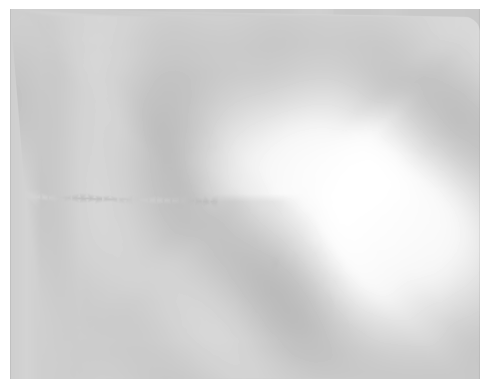

In [161]:
plt.imshow(fourier_transform, extent=(min(px), max(px), max(py), min(py)), origin='lower', cmap="gray")
plt.axis('off')
plt.margins(0)
plt.savefig('/home/lbisognin/Asmara/images/testing6.jpg', dpi=300, bbox_inches='tight', pad_inches=0)
plt.show()


In [162]:
fourier_transform[5600,60],fourier_transform[700,700]

(1878.1128630307676, 1906.2012167010746)

In [163]:
def create_inversion(img, MEDIUM_INDEX = None, WAVELENGTH = 15, SPACING = 0.5, distance = 30, zsteps = 40):
    
    assert MEDIUM_INDEX is not None, "MEDIUM_INDEX is not defined"
    
    # load image from file
    raw_holo = hp.load_image(img, 
                            medium_index=MEDIUM_INDEX, 
                            illum_wavelen=WAVELENGTH,
                            illum_polarization=(1,0), 
                            spacing=SPACING, channel=0)
                        
    zstack = np.linspace(0, distance, zsteps+1)
    rec_vol = hp.propagate(raw_holo, zstack)

    return rec_vol

In [164]:
inversion = create_inversion('/home/lbisognin/Asmara/images/testing6.jpg', 4)

In [165]:
inversion

<xarray.DataArray 'testing6' (z: 41, x: 1108, y: 1408)>
array([[[ 161.        +0.00000000e+00j,  207.        +0.00000000e+00j,
          209.        +0.00000000e+00j, ...,
          198.        +0.00000000e+00j,  198.        +0.00000000e+00j,
          198.        +0.00000000e+00j],
        [ 161.        +0.00000000e+00j,  207.        +0.00000000e+00j,
          209.        +0.00000000e+00j, ...,
          198.        +0.00000000e+00j,  198.        +0.00000000e+00j,
          198.        +0.00000000e+00j],
        [ 161.        +0.00000000e+00j,  207.        +0.00000000e+00j,
          209.        +0.00000000e+00j, ...,
          198.        +0.00000000e+00j,  198.        +0.00000000e+00j,
          198.        +0.00000000e+00j],
        ...,
        [ 160.        +0.00000000e+00j,  206.        +0.00000000e+00j,
          209.        +0.00000000e+00j, ...,
          198.        +0.00000000e+00j,  198.        +0.00000000e+00j,
          198.        +0.00000000e+00j],
        [ 160.        +0.00000000e+00j,  206.        +0.00000000e+00j,
          209.        +0.00000000e+00j, ...,
          198.        +0.00000000e+00j,  198.        +0.00000000e+00j,
...
          210.02217902-1.44015707e+00j, ...,
          203.04079209-3.19017105e+00j,  206.42029597-3.01329525e+00j,
          208.13175776-2.74473718e+00j],
        [ 170.56058157-2.79807300e+00j,  213.0303073 -2.40333576e+00j,
          210.06204228-1.90708200e+00j, ...,
          203.57325384-3.36920647e+00j,  206.92343138-3.28142159e+00j,
          208.55635494-3.09111451e+00j],
        ...,
        [ 170.07434501-7.63205591e-01j,  213.06582772-3.50946528e-01j,
          211.43943667+4.48219651e-02j, ...,
          202.45296418-1.68625916e+00j,  206.25367867-1.45151893e+00j,
          208.46347119-1.14164514e+00j],
        [ 169.55523594-9.86639697e-01j,  212.51387691-5.32340275e-01j,
          210.91863161-8.37991710e-02j, ...,
          202.28245256-2.02873994e+00j,  205.94667296-1.75475752e+00j,
          208.03252032-1.40441752e+00j],
        [ 169.216713  -1.37983941e+00j,  212.09129367-9.07873158e-01j,
          210.46696486-4.21795255e-01j, ...,
          202.3266914 -2.44110930e+00j,  205.8658933 -2.16283817e+00j,
          207.81612039-1.80620809e+00j]]])
Coordinates:
  * z        (z) float64 0.0 0.75 1.5 2.25 3.0 ... 27.0 27.75 28.5 29.25 30.0
  * x        (x) float64 0.0 0.5 1.0 1.5 2.0 ... 551.5 552.0 552.5 553.0 553.5
  * y        (y) float64 0.0 0.5 1.0 1.5 2.0 ... 701.5 702.0 702.5 703.0 703.5
Attributes:
    medium_index:        4
    illum_wavelen:       15
    illum_polarization:  <xarray.DataArray (vector: 3)>\narray([1., 0., 0.])\...
    noise_sd:            None

In [166]:
plane = np.abs(inversion[34])
px = (plane).x
py = (plane).y

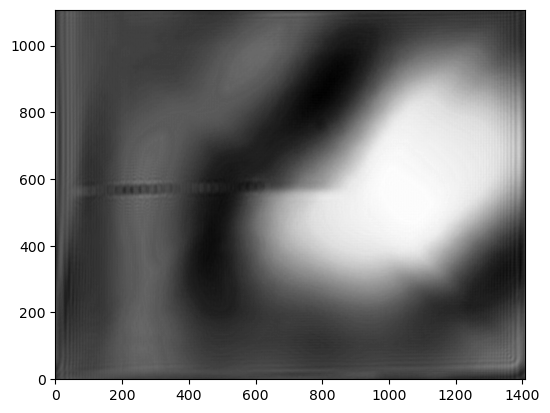

In [167]:
plt.imshow(plane, origin='lower', cmap='gray')
plt.show()

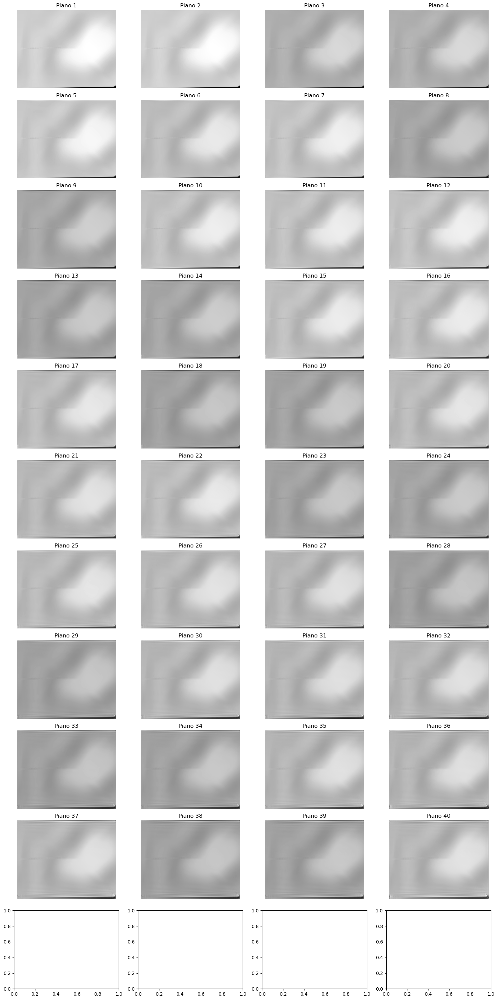

In [63]:
num_rows = 11
num_cols = 4

# Crea una nuova figura
fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 30))

# Itera attraverso tutti i piani
for i in range(0, 40):
    # Calcola l'indice di riga e colonna per il piano corrente
    row_index = i // num_cols
    col_index = i % num_cols
    
    # Estrai il piano corrente
    plane = np.abs(inversion[i])
    
    # Disegna il piano corrente sul subplot corrispondente
    axes[row_index, col_index].imshow(plane, origin='lower', cmap='gray')
    
    # Imposta i titoli delle colonne
    axes[row_index, col_index].set_title(f'Piano {i + 1}')
    
    # Nascondi le etichette degli assi per una migliore visualizzazione
    axes[row_index, col_index].axis('off')

# Aggiusta il layout per evitare sovrapposizioni
plt.tight_layout()
plt.show()